In [1]:
import torch
from hydra import compose, initialize
from conf.main_config import GlobalConfiguration
from omegaconf import OmegaConf
from torchvision.utils import make_grid
from matplotlib import pyplot as plt

from utils.utils import undersample_list
from src.DiffusionModel import DiffusionModel
from conf.dataset import ValueRange
from utils.utils import normalize_value_range

In [2]:
PATH = "diffusion_trained_blender1.ckpt"

In [3]:
initialize()
cfg = compose(config_name="globalConfiguration")
cfg: GlobalConfiguration = OmegaConf.to_object(cfg)
print(OmegaConf.to_yaml(cfg))

C:\Users\tmayet\AppData\Local\Temp\ipykernel_21180\3619389601.py:1: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  initialize()
C:\Users\tmayet\AppData\Local\Temp\ipykernel_21180\3619389601.py:1: UserWarning: config_path is not specified in hydra.initialize().
See https://hydra.cc/docs/next/upgrades/1.0_to_1.1/changes_to_hydra_main_config_path for more information.
  initialize()


defaults:
- _self_
- model_params/diffusion: ddim
seed: 42
checkpoint_params:
  model_checkpoint_on_monitor: true
  model_checkpoint_on_duration: true
  model_checkpoint_on_tick: true
  loading_for_test_mode: monitor
  dirpath: _model_save/
  auto_insert_metric_name: false
  save_weights_only: false
  verbose: true
  save_on_train_epoch_end: true
  save_last: true
  on_monitor__filename: '{epoch}_best_model'
  monitor: valid/loss
  mode: min
  on_monitor__every_n_epochs: 1
  on_monitor__save_top_k: 1
  on_duration__filename: '{epoch}_duration_model'
  on_duration__save_top_k: 1
  on_duration__every_n_epochs: 1
  on_tick__every_n_epochs: 1
  retrain_retrain_from_checkpoint: false
  retrain_saved_path: _model_save/last.ckpt
dataset_params:
  data_params:
    name: blender
    root: C:/Users/tmayet/Documents/datasets/blender_dataset/lmdb/random/blender_dataset_random.lmdb
    return_params: false
    is_one: true
    return_domain: null
    height: 64
    width: 64
    channels: 3
    n_c

In [4]:
model = DiffusionModel(cfg.model_params, cfg.dataset_params)
state_dict = torch.load(PATH)['state_dict']
model.load_state_dict(state_dict)

Is Time embed used ?  True


<All keys matched successfully>

In [6]:
model = model.cuda()
samples, samples_list, sample_x0s = model.generate_samples_ddim(20, True, True)

In [7]:
generated_data = undersample_list(samples_list, 20, 'quad')
generated_data0 = undersample_list(sample_x0s, 20, 'quad')

full_tensor = torch.cat(generated_data, dim=-1)
full_tensor_x0 = torch.cat(generated_data0, dim=-1)

full_tensor = torch.cat([full_tensor, full_tensor_x0], dim=-2)

full_tensor = normalize_value_range(full_tensor, ValueRange.OneUnbound, clip=True)

grid = make_grid(full_tensor, nrow=1)

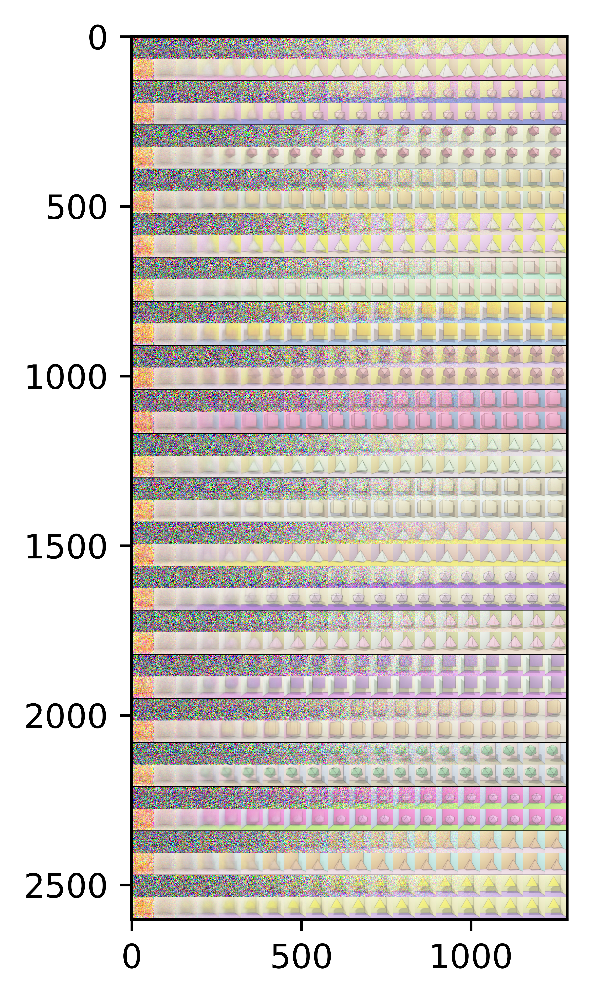

In [8]:
plt.figure(dpi=1200)
plt.imshow(grid.permute(1, 2, 0).cpu())
plt.show()
